# Analysis of the pretrained facenet

## Imports

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import rasterio as rio
import sklearn as sk
import scipy as sc
import seaborn as sns

In [5]:
import tqdm
#from tqdm import tqdm
from tqdm.notebook import tqdm # for notebooks
tqdm.pandas()

In [6]:
import pickle
import gc
collectAll = lambda : gc.collect(0) + gc.collect(1) + gc.collect(2)

In [7]:
#from pandarallel import pandarallel
#pandarallel.initialize(progress_bar=True)

In [8]:
#import itables
#from itables import show

In [9]:
from collections import namedtuple
import itertools
from itertools import product

In [10]:
from skimage.feature import graycomatrix
from skimage.feature import graycoprops
from math import pi

In [11]:
import PIL as pil
from PIL import Image, ImageDraw

In [14]:
#import papermill as pm

In [15]:
import math

In [16]:
import matplotlib
matplotlib.rcParams["image.origin"] = 'upper'

In [17]:
import os

In [18]:
import functools

In [22]:
import tensorflow as tf

In [23]:
import torch
import torchvision

In [24]:
from einops import *

## Load in the pretrained facenet

In [25]:
import model
from model import face_model

In [26]:
import importlib
model = importlib.reload(model)
face_model = model.face_model

In [27]:
class Params():
    def __init__(self):
        self.image_size = 250
        self.embedding_size=128

In [28]:
fm = face_model(Params())

In [29]:
checkpoint = tf.train.Checkpoint(fm)

In [30]:
checkpoint.restore('../weights/weights/ckpt/ckpt-11')

## Load in our data and apply the GLCM filter

In [ ]:
from pathlib import Path
result = Path("./glcms_3_7_128").rglob("*.npz")

In [ ]:
df = pd.DataFrame(result, columns=['npz_path'])

In [ ]:
df['path_str_split'] = df['npz_path'].apply(lambda x: str(x)).str.split('\\')

In [ ]:
df['phase'] = df['path_str_split'].apply(lambda x: x[1]).astype("category")

In [ ]:
df['filename'] = df['path_str_split'].apply(lambda x: x[-1])

In [ ]:
df[['species', 'tree_id']] = df['filename'].str.split('_').apply(lambda x: pd.Series(x[:2]))

In [ ]:
df['species'] = df['species'].astype('category')

In [ ]:
df['tree_id'] = df['tree_id'].str.split('.').apply(lambda x: x[0]).astype("int")

In [ ]:
df_nv = df[['npz_path', 'phase', 'species', 'tree_id']]

In [ ]:
df_nv.head()

In [ ]:
def get_glcm(filename_or_arr, is_filename=True):
    if is_filename:
        arr = np.load(filename_or_arr, allow_pickle=True)
    else:
        arr = filename_or_arr
    rval = arr
    return rval

In [ ]:
df['glcm'] = df['npz_path'].progress_apply(lambda x: get_glcm(x))

In [ ]:
df['glcm'].iloc[0].shape

In [ ]:
df = df[df['species'] != 'Cratoxylum Formosum']

In [ ]:
df = df[df['glcm'].apply(lambda x: x.shape[0]) >= 64]
df = df[df['glcm'].apply(lambda x: x.shape[1]) >= 64]

In [ ]:
len(df)

In [ ]:
def crop_center(img,cropx,cropy):
    y,x = img.shape[:2]
    if y < cropy or x < cropx:
        return float('NaN')
    startx = x//2-(cropx//2)
    starty = y//2-(cropy//2)    
    return img[starty:starty+cropy,startx:startx+cropx]

In [ ]:
def whiten_image(x):
    return (x-x.mean(axis=(0,1), keepdims=True))/x.std(axis=(0,1), keepdims=True)

In [ ]:
bands = ['wr', 'wg', 'wb', 'red_edge', 'b', 'nir', 'r', 'g']
props = ['mean_no_glcm', 'homogeneity', 'contrast', 'asm', 'mean', 'var', 'correlation']

In [ ]:
channels = [bands.index(i) for i in ['r', 'g', 'b', 'red_edge', 'nir']]

In [ ]:
props.index('mean')

In [ ]:
df['glcm'].iloc[0][:,:,channels][:,:,:,[0,props.index('mean')]].shape

In [ ]:
df['whitened'] = df['glcm'].progress_apply(lambda x: rearrange(
    torchvision.transforms.functional.resize(
        torch.Tensor(rearrange(whiten_image(crop_center(x[:,:,channels][:,:,:,[0,props.index('mean')]], 64, 64)),
                               '(b h) w c p -> b (p c) h w', b=1)), (160, 160), antialias=True).numpy(),
    'b c h w -> b h w c'))

In [ ]:
plt.imshow(df['glcm'].iloc[0][:,:,channels[:3],props.index('mean_no_glcm')])

In [ ]:
plt.imshow(df['glcm'].iloc[0][:,:,channels[:3],props.index('mean')])

In [ ]:
plt.imshow(df['glcm'].iloc[0][:,:,channels[3],props.index('mean')])

In [ ]:
plt.imshow(df['glcm'].iloc[0][:,:,channels[4],props.index('mean')])

In [ ]:
plt.imshow(rearrange(df['whitened'].iloc[0], 'b h w c -> (b h) w c')[:,:,:3])

In [ ]:
plt.imshow(rearrange(df['whitened'].iloc[0], 'b h w c -> (b h) w c')[:,:,5:8])

## Get the outputs of our conversion layers

In [399]:
fm.conversion_layer

In [400]:
x = df['whitened'].iloc[0]

In [401]:
df['conversion_layer_outputs'] = df['whitened'].progress_apply(lambda x: fm.conversion_layer_1(fm.conversion_layer_2(fm.conversion_layer(x))))

  0%|          | 0/63 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


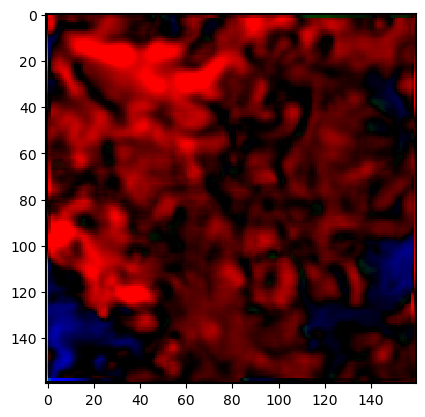

In [402]:
plt.imshow(rearrange(df['conversion_layer_outputs'].iloc[0], 'b h w c -> (b h) w c'))

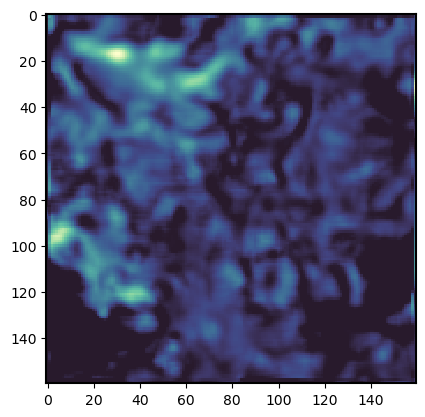

In [403]:
plt.imshow(rearrange(df['conversion_layer_outputs'].iloc[0], 'b h w c -> (b h) w c')[:,:,0])

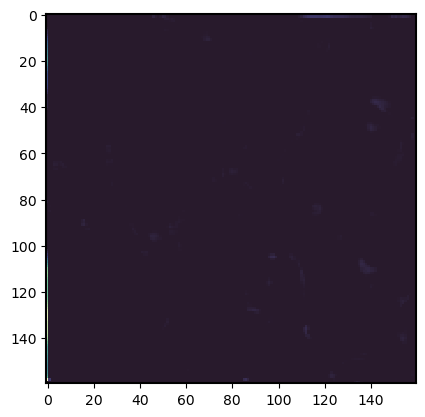

In [404]:
plt.imshow(rearrange(df['conversion_layer_outputs'].iloc[0], 'b h w c -> (b h) w c')[:,:,1])

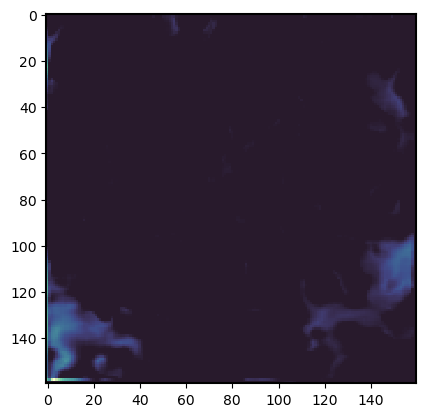

In [405]:
plt.imshow(rearrange(df['conversion_layer_outputs'].iloc[0], 'b h w c -> (b h) w c')[:,:,2])

### Whoa, that's interesting... Can we get the outputs of the conversion layers for the first 3 images?

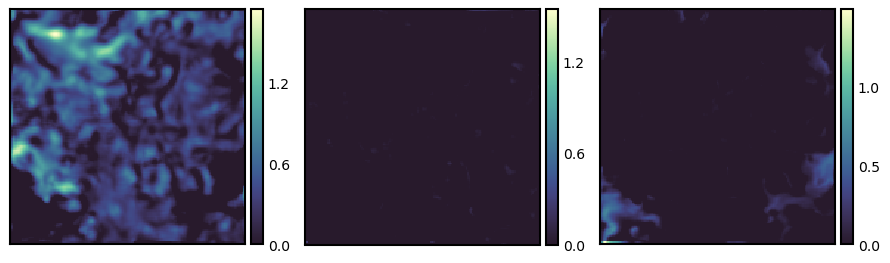

In [433]:
isns.ImageGrid(rearrange(df['conversion_layer_outputs'].iloc[0], 'b h w c -> (b h) w c'))

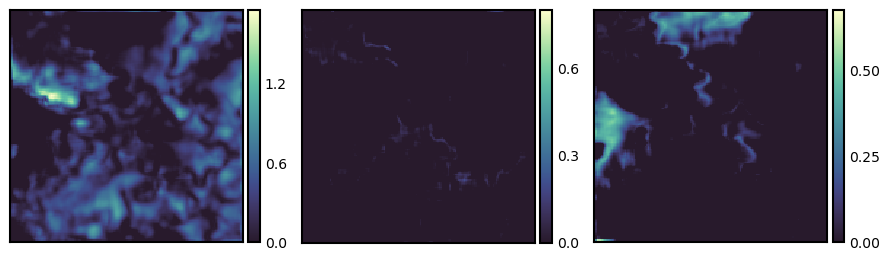

In [407]:
isns.ImageGrid(rearrange(df['conversion_layer_outputs'].iloc[2], 'b h w c -> (b h) w c'))

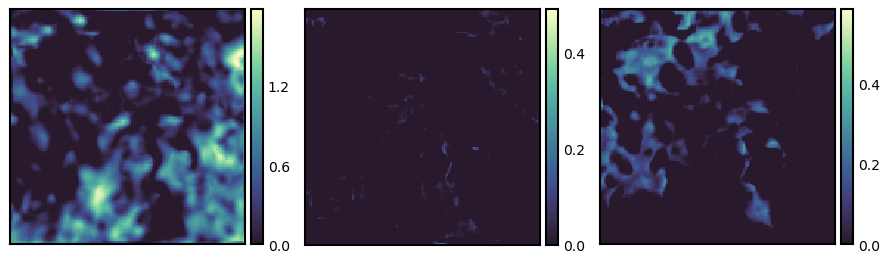

In [408]:
isns.ImageGrid(rearrange(df['conversion_layer_outputs'].iloc[3], 'b h w c -> (b h) w c'))

## What about a chart of the conversion layer outputs for all of the images?

In [409]:
df['filename']

0        Alstonia Angulstiloba_14.npz
1        Alstonia Angulstiloba_20.npz
2                  Bridelia Sp._2.npz
3                 Bridelia Sp._22.npz
5     Campnosperma Auriculatum_28.npz
                   ...               
62        Sterculia Parviflora_26.npz
63        Sterculia Parviflora_30.npz
64         Syzygium Polyanthum_16.npz
65          Syzygium Polyanthum_9.npz
66           Terminalia Catappa_6.npz
Name: filename, Length: 63, dtype: object

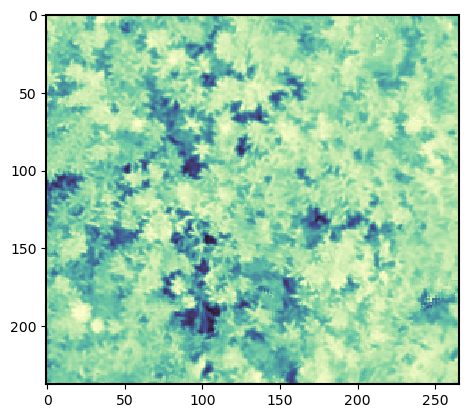

In [410]:
plt.imshow(df['glcm'].iloc[0][:,:,0,0])

In [411]:
df.iloc[4]['filename']

'Campnosperma Auriculatum_28.npz'

In [412]:
df['glcm'].iloc[4][:,:,0,0].shape

(705, 332)

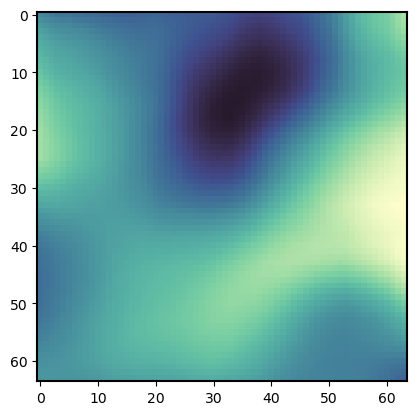

In [427]:
plt.imshow(crop_center(df['whitened'].iloc[4][0,:,:,9], 64, 64))

In [434]:
fig, ax = plt.subplots(66, 6, figsize=(5.6*4, 4.8*66))
row_num = 0
for idx, row in tqdm(df.iterrows()):
    row_ax = ax[row_num]
    row_ax[0].set_xlabel(str((row['filename'], row['phase'])))
    row_ax[0].set_ylabel('whitened_rgb')
    row_ax[1].set_ylabel('whitened_red_edge')
    row_ax[2].set_ylabel('whitened_nir')
    row_ax[3].set_ylabel('out1')
    row_ax[4].set_ylabel('out2')
    row_ax[5].set_ylabel('out3')
    row_ax[0].imshow(row['whitened'][0,:,:,:3])
    row_ax[1].imshow(row['whitened'][0,:,:,3])
    row_ax[2].imshow(row['whitened'][0,:,:,4])
    row_ax[3].imshow(row['conversion_layer_outputs'][0,:,:,0])
    row_ax[4].imshow(row['conversion_layer_outputs'][0,:,:,1])
    row_ax[5].imshow(row['conversion_layer_outputs'][0,:,:,2])
    row_num += 1
plt.tight_layout()

0it [00:00, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i